In [57]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, PolynomialFeatures
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.linear_model import LinearRegression, TweedieRegressor, QuantileRegressor 
from sklearn.feature_selection import SelectFromModel
import optuna
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import mean_absolute_percentage_error, mean_absolute_error, root_mean_squared_error
from sklearn.linear_model import Lasso
from cuml.linear_model import Lasso as cuLasso
from sklearn.model_selection import KFold
from statsmodels.sandbox.panel.sandwich_covariance_generic import kernel
from sklearn.linear_model import Lasso
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.linear_model import SGDRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C
from sklearn.model_selection import  cross_val_score
from sklearn.metrics import mean_squared_error
from sklearn.linear_model import RANSACRegressor
from sklearn.linear_model import HuberRegressor
from sklearn.linear_model import TheilSenRegressor
import os
import joblib
from cuml.svm import SVR as cuSVR
import cupy as cp
import cudf
import gc
from cuml.neighbors import KNeighborsRegressor as cuKNeighborsRegressor
from cuml import LinearRegression as cuLinearRegression 
from cuml import MBSGDRegressor as cuSGDRegressor
from cuml.ensemble import RandomForestRegressor as cuRandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from cuml.svm import LinearSVR as cuLinearSVR

# Regression Models

For the regression task, our target variable will be the `AMT_CREDIT` column. We are going to create a class `RegressionMetrics` to compute all the metrics. After computing them, we can print all the results of the different algorithms on a visually appealing table. This class will evaluate the performance of the models using the K Fold method, with 10 folds. We are going to use the following metrics: MSE, RMSE, R^2, MAE, MAPE and Adjusted R^2.

For the model building, firstly we are going to use `SelectFromModel` to select the most important features for each model, when possible because every model doesn't allow to use `SelectFromModel`. Then we are going to do the hyperparameter tunning with the Optuna framework. For this task, the metric we are going to maximize with Optuna is NMSE (Negative Mean Squared Error), obtained using a cross validation with `cross_val_score`. It is important to take into account that NMSE was chosen because MSE is not supported by `cross_val_score`, maximizing the NMSE is equivalent to minimize the MSE. After obtaining the best hyperparameters for the model, we will evaluate them with the already mentioned `RegressionMetrics` class.

To make the evaluation process easier, we have used the `joblib` library to be able to save the model in our local disk. This has been very useful because it enables us to save the best model obtained after the hyperparameter tunning and evaluating it in other moment.

We also have to mentioned that some algorithms had a very long training time for the scope of this project. Taking this into consideration, we have decided to use samples of the dataset for these algorithms. Also, for these algorithms with high training time we have made less Optuna trials.

In [58]:
class RegressionMetrics:
    results_df = pd.DataFrame()

    def __init__(self, model, X, y):
        self.model = model
        self.X = pd.DataFrame(X).reset_index(drop=True)
        self.y = pd.Series(y).reset_index(drop=True)
        self.mse =[]
        self.rmse = []
        self.r2 = []
        self.mae = []
        self.mape = []
        self.adj_r2 = []

    def compute_metrics(self,y_test,y_pred):
        mse = mean_squared_error(y_test, y_pred)
        self.mse.append(mse)

        rmse = root_mean_squared_error(y_test, y_pred)
        self.rmse.append(rmse)

        r2 = r2_score(y_test, y_pred)
        self.r2.append(r2)

        #adjusted r^2
        n = len(self.X)
        p = len(self.X.columns)
        adj_r2 = 1 - (1 - r2) * (n - 1) / (n - p - 1)
        self.adj_r2.append(adj_r2)

        mae = mean_absolute_error(y_test, y_pred)
        self.mae.append(mae)

        mape = mean_absolute_percentage_error(y_test, y_pred)
        self.mape.append(mape)

    def Kfold_evaluation(self):
        kf = KFold(n_splits=10, random_state=42, shuffle=True)
        for train_index, test_index in kf.split(self.X,self.y):
            X_train, X_test = self.X.iloc[train_index, :], self.X.iloc[test_index, :]
            y_train, y_test = self.y.iloc[train_index], self.y.iloc[test_index]
            self.model.fit(X_train, y_train)
            y_pred = self.model.predict(X_test)
            self.compute_metrics(y_test,y_pred)

    def printMetrics(self):
        print(f'MSE: {round(np.mean(self.mse),4)}')
        print(f'RMSE: {round(np.mean(self.rmse),4)}')
        print(f'R2: {round(np.mean(self.r2),4)}')
        print(f'MAE: {round(np.mean(self.mae),4)}')
        print(f'MAPE: {round(np.mean(self.mape),4)}')
        print(f'Adjusted R2: {round(np.mean(self.adj_r2),4)}')

    def save_results(self,algorithm):
        results = {
            "Algorithm": algorithm,
            "MSE": round(np.mean(self.mse),4),
            "RMSE": round(np.mean(self.rmse),4),
            "R2": round(np.mean(self.r2),4),
            "MAE": round(np.mean(self.mae), 4),
            "MAPE": round(np.mean(self.mape), 4),
            "Adjusted R2": round(np.mean(self.adj_r2), 4),
        }
        RegressionMetrics.results_df = pd.concat(
            [RegressionMetrics.results_df, pd.DataFrame([results])],
            ignore_index=True
        )

    def save_model(self, path):
        directory = os.path.dirname(path)
        if not os.path.exists(directory):
            os.makedirs(directory)
        joblib.dump(self.model, path)

    @staticmethod
    def printResults():
        styled_df = (RegressionMetrics.results_df.style
                     .set_table_styles([  # Estilo de la tabla
                         {'selector': 'th',
                          'props': [('background-color', '#f0f0f0'),
                                    ('font-weight', 'bold'),
                                    ('text-align', 'center'),
                                    ('color', 'black')]},
                         {'selector': 'td',
                          'props': [('text-align', 'center'),
                                    ('background-color', '#f0f0f0'),
                                    ('color', 'black')]},
                         {'selector': 'td:nth-child(1)',
                          'props': [('background-color', '#f0f0f0'),
                                    ('font-weight', 'bold')]}])
                     .format("{:.4f}", subset=RegressionMetrics.results_df.columns.drop('Algorithm'))
                     )

        display(styled_df.hide(axis='index'))


Loading the data.

In [59]:
df = pd.read_parquet('../data/processed/selected_features_df.parquet')
X = df.drop('AMT_CREDIT', axis=1)
X = X.drop('AMT_GOODS_PRICE', axis=1)
y = df['AMT_CREDIT'].reset_index(drop=True)

Standardizing the data using the StandardScaler.

In [60]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled,columns = X.columns)

## Linear Regression

For Linear Regression we are not going to use Optuna because it doesn't have hyperparameters to tune. We are going to train the model with the data and compute the metrics. 

Firstly, we create the model and save it.

#### METRICS

In [16]:
model = cuLinearRegression()
metrics = RegressionMetrics(model, X_scaled, y)
metrics.save_model('../models/LinearRegression.pkl')

Load the model and evaluate it.

In [26]:
model = joblib.load("../models/LinearRegression.pkl")
metrics = RegressionMetrics(model, X_scaled, y)
metrics.Kfold_evaluation()
metrics.save_results("Linear Regression")
metrics.printMetrics()

MSE: 0.2096
RMSE: 0.3478
R2: 0.997
MAE: 0.2769
MAPE: 0.0048
Adjusted R2: 0.997


The results are excellent for this model. The prediction errors are negligible relative to the true values, showcasing both precision and reliability. The model shows a very strong predictive accuracy.

## Lasso Regression

Using SelectFromModel to get the best features for Lasso.

In [61]:
lasso = Lasso(alpha=0.001, max_iter=10000)
selector = SelectFromModel(estimator=lasso)
X_selected = selector.fit_transform(X_scaled, y)

#### HYPERPARAMETER TUNING

In [62]:
def objective(trial):
    tol = trial.suggest_float('tol', 1e-6, 1e-2, log = True)
    alpha = trial.suggest_float('alpha', 1e-6, 1e-2, log = True)
    lasso = cuLasso(alpha=alpha, tol=tol, max_iter=1000)

    cv_scores = cross_val_score(lasso, X_selected, y, cv=5, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='Lasso Regression')
study.optimize(objective, n_trials=10)

[I 2024-12-23 19:05:27,371] A new study created in memory with name: Lasso Regression
[I 2024-12-23 19:05:29,944] Trial 0 finished with value: -0.04372797643740166 and parameters: {'tol': 9.83384772238771e-06, 'alpha': 0.0028629309709137843}. Best is trial 0 with value: -0.04372797643740166.
[I 2024-12-23 19:05:30,359] Trial 1 finished with value: -0.043964213047611056 and parameters: {'tol': 0.0006007625280670492, 'alpha': 1.7851184202980535e-06}. Best is trial 0 with value: -0.04372797643740166.
[I 2024-12-23 19:05:33,421] Trial 2 finished with value: -0.043597766759989304 and parameters: {'tol': 5.2526095451252666e-06, 'alpha': 0.0006297749517379161}. Best is trial 2 with value: -0.043597766759989304.
[I 2024-12-23 19:05:36,323] Trial 3 finished with value: -0.04363208501491973 and parameters: {'tol': 5.962937041715912e-05, 'alpha': 0.0013173923613498753}. Best is trial 2 with value: -0.043597766759989304.
[I 2024-12-23 19:05:36,701] Trial 4 finished with value: -0.04416393145205737

#### STUDY RESULTS

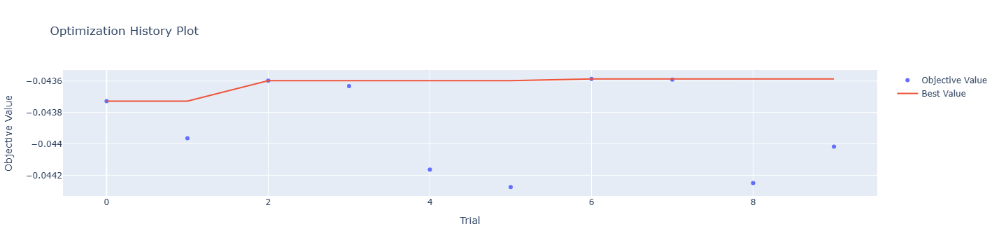

In [63]:
optuna.visualization.plot_optimization_history(study)

On this plot we can see how Optuna is optimizing the NMSE during the trials. We can see that the score almost hasn't improved since the first trial.

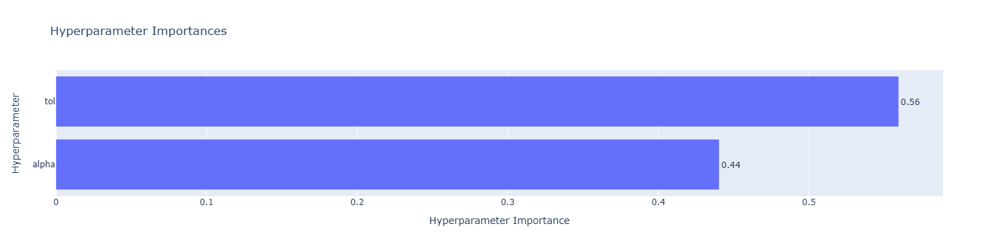

In [64]:
optuna.visualization.plot_param_importances(study)

The parameter "tol" has a higher importance (0.56) than "alpha" (0.44). This indicates that "tol" contributes more to improving the model's predictions than "alpha".

#### METRICS

Now we are going to save and evaluate the model.

Firstly, we create the model and save it.

In [8]:
model = cuLasso(**study.best_params, max_iter=1000)
metrics = RegressionMetrics(model, X_selected, y)
metrics.save_model('../models/lassoRegression.pkl')

Load the model and evaluate it.

In [28]:
model = joblib.load("../models/lassoRegression.pkl")
metrics = RegressionMetrics(model, X_selected, y)
metrics.Kfold_evaluation()
metrics.save_results("Lasso")
metrics.printMetrics()

MSE: 0.0436
RMSE: 0.2088
R2: 0.9994
MAE: 0.1551
MAPE: 0.0027
Adjusted R2: 0.9994


The low value of MSE and RMSE indicates that the model is making good predictions. R2 is close to 1, which means that the model explains most of the variance in the target variable. MAPE is close to 0, which highlights the excellent performance of the model in terms of percentage error.

## Linear Support Vector Regression (SVR) 

Using SelectFromModel to get the best features for Linear Support Vector Regressor.

In [29]:
svr = cuLinearSVR()
selector = SelectFromModel(estimator=svr).fit(X_scaled, y)
X_selected = selector.transform(X_scaled)

#### HYPERPARAMETER TUNING

In [43]:
def objective(trial):
    gc.collect()
    cp._default_memory_pool.free_all_blocks()

    C = trial.suggest_float('C', 1e-5, 1e2,log=True)
    tol = trial.suggest_float('tol', 1e-5, 1e-1, log=True)
    max_iter = trial.suggest_int('max_iter', 100, 1000)
    loss = trial.suggest_categorical('loss', ['squared_epsilon_insensitive', 'epsilon_insensitive'])

    svr = cuLinearSVR(C=C, tol=tol, max_iter=max_iter, loss=loss)
    cv_scores = cross_val_score(svr, X_scaled, y, cv=5, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='Linear SVR Regression')
study.optimize(objective, n_trials=10)

[I 2024-12-23 16:02:27,733] A new study created in memory with name: Linear SVR Regression
[I 2024-12-23 16:02:29,426] Trial 0 finished with value: -0.0435957706936065 and parameters: {'C': 0.14070520664666364, 'tol': 0.006239636919692364, 'max_iter': 101, 'loss': 'squared_epsilon_insensitive'}. Best is trial 0 with value: -0.0435957706936065.
[I 2024-12-23 16:02:30,661] Trial 1 finished with value: -0.04359671434953758 and parameters: {'C': 0.1104872861061998, 'tol': 1.1578339413710347e-05, 'max_iter': 605, 'loss': 'squared_epsilon_insensitive'}. Best is trial 0 with value: -0.0435957706936065.
[I 2024-12-23 16:02:32,794] Trial 2 finished with value: -0.048745133102884995 and parameters: {'C': 0.8872593780836954, 'tol': 0.009416029757712729, 'max_iter': 442, 'loss': 'epsilon_insensitive'}. Best is trial 0 with value: -0.0435957706936065.
[I 2024-12-23 16:02:34,047] Trial 3 finished with value: -0.043597342002336094 and parameters: {'C': 0.6575750712679953, 'tol': 0.001408546813181396,

#### STUDY RESULTS

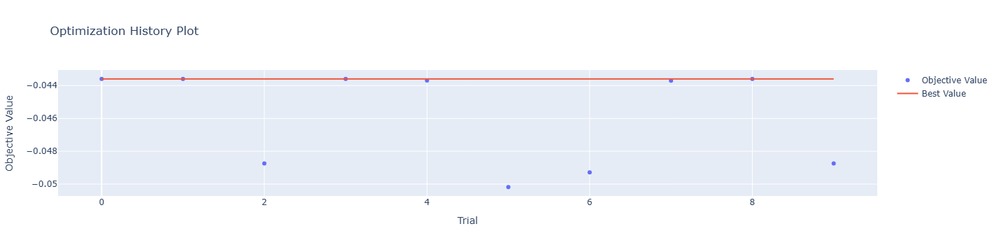

In [44]:
optuna.visualization.plot_optimization_history(study)

On this plot we can see how Optuna is optimizing the NMSE during the trials. We can see that the score hasn't improved since the first trial.

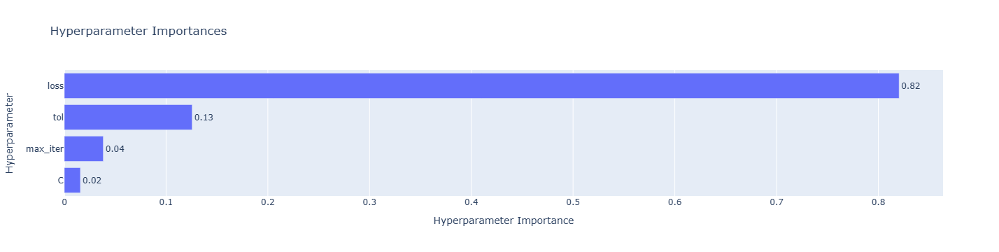

In [45]:
optuna.visualization.plot_param_importances(study)

We can see that "loss" hyperparameter is by far the one with the greatest importance. "max_iter" and "C" have very low values, which mean that they are not improving model's predictive power.

#### METRICS

Now we are going to save and evaluate the model.

Firstly, we create the model and save it.

In [47]:
model = cuLinearSVR(**study.best_params)
metrics = RegressionMetrics(model, X_scaled, y)
metrics.save_model('../models/linearSVR.pkl')

Load the model and evaluate it.

In [30]:
model = joblib.load("../models/linearSVR.pkl")
metrics = RegressionMetrics(model, X_selected, y)
metrics.Kfold_evaluation()
metrics.save_results("Linear SVR")
metrics.printMetrics()

MSE: 0.044
RMSE: 0.2098
R2: 0.9994
MAE: 0.1561
MAPE: 0.0027
Adjusted R2: 0.9994


The low value of MSE and RMSE indicates that the model is making good predictions. R2 is close to 1, which means that the model explains most of the variance in the target variable. MAPE is close to 0, which highlights the excellent performance of the model in terms of percentage error.

## Non-Linear Support Vector Regression (SVR) 

Non-Linear SVR doesn't support selectFromModel, so we are going to use the Linear SV.

In [31]:
svr = cuLinearSVR()
selector = SelectFromModel(estimator=svr).fit(X_scaled, y)
X_selected = selector.transform(X_scaled)

Due to high training times, we are going use a sample of 10000 rows for this model.

In [32]:
X_sample = pd.DataFrame(X_selected).sample(n=10000,random_state=42)
y_sample = y.loc[X_sample.index]

#### HYPERPARAMETER TUNING

In [ ]:
def objective(trial):
    gc.collect()
    cp._default_memory_pool.free_all_blocks()
    
    C = trial.suggest_float('C', 1e-3, 1e3, log=True)
    epsilon = trial.suggest_float('epsilon', 0.01, 0.5)
    kernel = trial.suggest_categorical('kernel', ['poly', 'rbf', 'sigmoid'])
    gamma = trial.suggest_categorical('gamma', ['scale', 'auto'])

    svr = cuSVR(C=C, epsilon=epsilon, kernel=kernel, gamma=gamma, max_iter=400)
    
    cv_scores = cross_val_score(svr, X_sample, y_sample, cv=5, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='SVR Regression')
study.optimize(objective, n_trials=10)

[I 2024-12-23 16:10:05,169] A new study created in memory with name: SVR Regression
[I 2024-12-23 16:10:06,330] Trial 0 finished with value: -1.3638078425216968 and parameters: {'C': 0.03403236924359377, 'epsilon': 0.39207120920205724, 'kernel': 'sigmoid', 'gamma': 'auto'}. Best is trial 0 with value: -1.3638078425216968.
[I 2024-12-23 16:10:08,031] Trial 1 finished with value: -5.858765377972442 and parameters: {'C': 0.3602341702405539, 'epsilon': 0.3387422883755822, 'kernel': 'poly', 'gamma': 'scale'}. Best is trial 0 with value: -1.3638078425216968.
[I 2024-12-23 16:10:09,348] Trial 2 finished with value: -3427.8085453468784 and parameters: {'C': 1.9677331949145846, 'epsilon': 0.047818245842212, 'kernel': 'sigmoid', 'gamma': 'scale'}. Best is trial 0 with value: -1.3638078425216968.
[I 2024-12-23 16:10:10,597] Trial 3 finished with value: -37.054896404273315 and parameters: {'C': 0.007482392851296347, 'epsilon': 0.45319873349105744, 'kernel': 'poly', 'gamma': 'scale'}. Best is trial

#### STUDY RESULTS

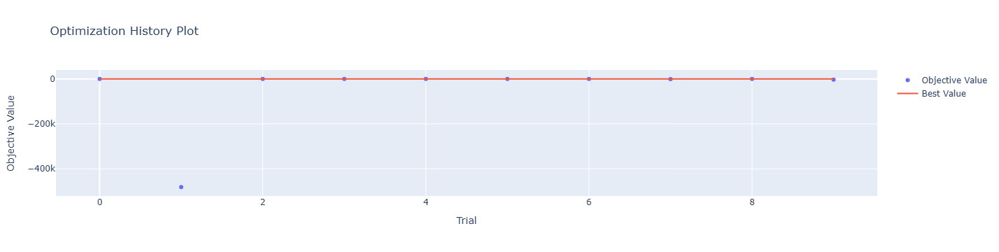

In [11]:
optuna.visualization.plot_optimization_history(study)

On this plot we can see how Optuna is optimizing the NMSE during the trials. We can see that the score hasn't improved since the first trial.

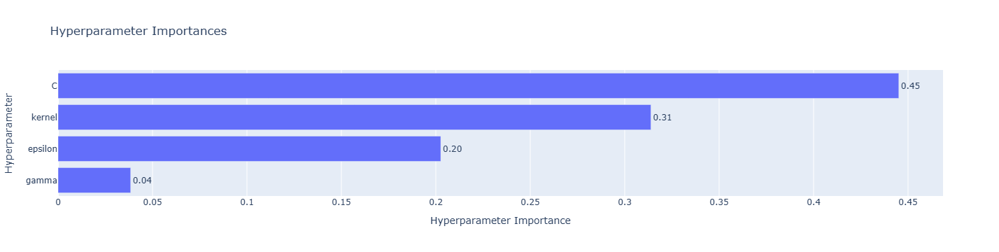

In [10]:
optuna.visualization.plot_param_importances(study)

"C" is the most hyperparameter followed by "kernel" and "epsilon". "gamma" has a very low importance, which means that they do not contribute much to improving the model's predictions.

#### METRICS

Firstly, we create the model and save it.

Train the model with the best found hyperparameters and compute SVR metrics 

In [8]:
model = cuSVR(**study.best_params, max_iter=400)
metrics = RegressionMetrics(model, X_sample, y_sample)
metrics.save_model('../models/nonLinearSVR.pkl')

Load the model and evaluate it.

In [33]:
model = joblib.load("../models/nonLinearSVR.pkl")
metrics = RegressionMetrics(model, X_sample, y_sample)
metrics.Kfold_evaluation()
metrics.save_results("Non-Linear SVR")
metrics.printMetrics()

MSE: 0.0748
RMSE: 0.2711
R2: 0.9989
MAE: 0.1325
MAPE: 0.0023
Adjusted R2: 0.9989


The low value of MSE and RMSE indicates that the model is making good predictions. R2 is close to 1, which means that the model explains most of the variance in the target variable. MAPE is close to 0, which highlights the excellent performance of the model in terms of percentage error.

## Nearest Neighbor Regression (KNN Regression)


As this algorithm is not supported by selectFromModel we are going tu start with the hyperparameter tuning.

#### HYPERPARAMETER TUNING

In [19]:
def objective(trial):
    n_neighbors = trial.suggest_int('n_neighbors', 1, 20)
    metric = trial.suggest_categorical('metric', ['euclidean', 'manhattan'])
    
    knn_model = cuKNeighborsRegressor(n_neighbors=n_neighbors, metric=metric)

    cv_scores = cross_val_score(knn_model, X_scaled, y, cv=5, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='KNN Regression')
study.optimize(objective, n_trials=10)

[I 2024-12-23 12:30:58,753] A new study created in memory with name: KNN Regression


[I] [12:30:58.758607] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:00.329672] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:01.424818] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:02.547394] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:03.647754] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:04,777] Trial 0 finished with value: -14.248947526923383 and parameters: {'n_neighbors': 9, 'metric': 'manhattan'}. Best is trial 0 with value: -14.248947526923383.


[I] [12:31:04.781361] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:05.874687] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:07.004883] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:08.186874] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:09.326373] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:10,462] Trial 1 finished with value: -14.114770166903147 and parameters: {'n_neighbors': 10, 'metric': 'manhattan'}. Best is trial 1 with value: -14.114770166903147.


[I] [12:31:10.465286] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:11.594503] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:12.732638] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:13.938591] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:15.069766] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:16,231] Trial 2 finished with value: -15.178353472352436 and parameters: {'n_neighbors': 6, 'metric': 'manhattan'}. Best is trial 1 with value: -14.114770166903147.


[I] [12:31:16.233882] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:17.463539] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:18.749992] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:20.045047] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:21.372243] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:22,661] Trial 3 finished with value: -18.687998040685592 and parameters: {'n_neighbors': 14, 'metric': 'euclidean'}. Best is trial 1 with value: -14.114770166903147.


[I] [12:31:22.664639] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:24.010310] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:25.248142] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:26.607181] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:27.878395] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:29,249] Trial 4 finished with value: -18.628541811755788 and parameters: {'n_neighbors': 17, 'metric': 'euclidean'}. Best is trial 1 with value: -14.114770166903147.


[I] [12:31:29.252460] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:30.403120] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:31.618447] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:32.847051] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:34.073469] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:35,223] Trial 5 finished with value: -13.795727105618152 and parameters: {'n_neighbors': 18, 'metric': 'manhattan'}. Best is trial 5 with value: -13.795727105618152.


[I] [12:31:35.226693] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:36.491860] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:37.749004] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:39.105359] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:40.384401] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:41,675] Trial 6 finished with value: -18.633307683939773 and parameters: {'n_neighbors': 18, 'metric': 'euclidean'}. Best is trial 5 with value: -13.795727105618152.


[I] [12:31:41.679121] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:42.811867] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:43.960332] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:45.150170] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:46.372321] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:47,609] Trial 7 finished with value: -13.795727105618152 and parameters: {'n_neighbors': 18, 'metric': 'manhattan'}. Best is trial 5 with value: -13.795727105618152.


[I] [12:31:47.613183] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:48.953473] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:50.288082] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:51.595945] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:52.884552] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:31:54,226] Trial 8 finished with value: -18.66075393493612 and parameters: {'n_neighbors': 20, 'metric': 'euclidean'}. Best is trial 5 with value: -13.795727105618152.


[I] [12:31:54.230442] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:55.479991] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:56.758787] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:58.063978] Unused keyword parameter: n_jobs during cuML estimator initialization
[I] [12:31:59.389125] Unused keyword parameter: n_jobs during cuML estimator initialization


[I 2024-12-23 12:32:00,647] Trial 9 finished with value: -19.382184470949706 and parameters: {'n_neighbors': 8, 'metric': 'euclidean'}. Best is trial 5 with value: -13.795727105618152.


#### STUDY RESULTS

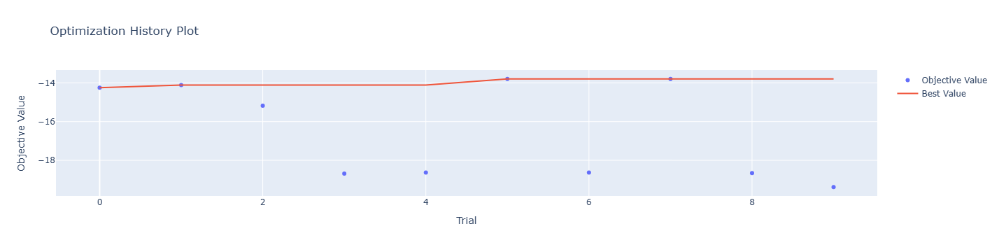

In [25]:
optuna.visualization.plot_optimization_history(study)

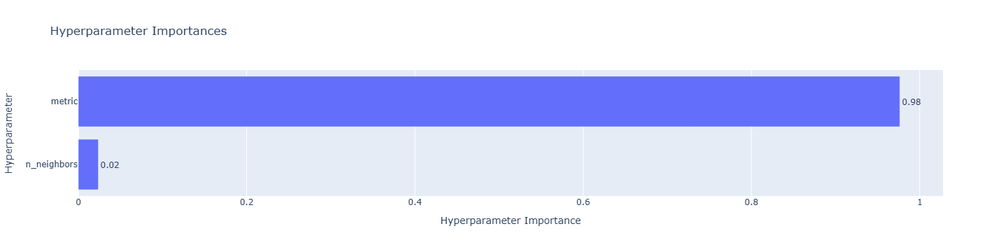

In [26]:
optuna.visualization.plot_param_importances(study)

We can appreciate that the most important hyperparameter is "metric". "n_neighbors" has almost 0 importance, which means that it doesn't contibute to the model performance.

#### METRICS

We are going to save the model with the best hyperparameters

In [22]:
model = cuKNeighborsRegressor(**study.best_params, max_iter=1000)
metrics = RegressionMetrics(model, X_scaled, y)
metrics.save_model('../models/knnRegressor.pkl')

[I] [12:33:05.181275] Unused keyword parameter: max_iter during cuML estimator initialization


Load the model and evaluating it.

In [34]:
model = joblib.load("../models/knnRegressor.pkl")
metrics = RegressionMetrics(model, X_scaled, y)
metrics.Kfold_evaluation()
metrics.save_results("KNN")
metrics.printMetrics()

MSE: 13.6241
RMSE: 3.691
R2: 0.802
MAE: 2.8751
MAPE: 0.0501
Adjusted R2: 0.8019


This model is not accurate as it gives a high error rate, both in MSE and RMSE. The R2 value (0.8) is much lower than in the rest of the models. This model is probably not the best to use for regression given our data.

## Generalized Linear Regression

Using SelectFromModel to get the best features for Tweedie Regressor.

In [35]:
tweedie = TweedieRegressor()
selector = SelectFromModel(estimator=tweedie)
X_selected = selector.fit_transform(X_scaled, y)

#### HYPERPARAMETER TUNING

In [33]:
def objective(trial):
    power = trial.suggest_float('power', 1, 3)
    alpha = trial.suggest_float('alpha', 1e-6, 100, log=True)
    tw = TweedieRegressor(power=power, alpha=alpha, max_iter=10000)
    
    cv_scores = cross_val_score(tw, X_selected, y, cv=5, scoring='neg_mean_squared_error')
    
    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='Tweedie Regression')
study.optimize(objective, n_trials=10)

[I 2024-12-23 12:38:30,116] A new study created in memory with name: Tweedie Regression
[I 2024-12-23 12:38:32,175] Trial 0 finished with value: -28.911031021394137 and parameters: {'power': 1.6518371368978926, 'alpha': 21.06444321552952}. Best is trial 0 with value: -28.911031021394137.
[I 2024-12-23 12:38:35,644] Trial 1 finished with value: -0.2776192755117245 and parameters: {'power': 2.429584700973342, 'alpha': 0.00011882986148662468}. Best is trial 1 with value: -0.2776192755117245.
[I 2024-12-23 12:38:39,530] Trial 2 finished with value: -0.250614034998017 and parameters: {'power': 1.3648880220863606, 'alpha': 2.705989244565115e-06}. Best is trial 2 with value: -0.250614034998017.
[I 2024-12-23 12:38:40,710] Trial 3 finished with value: -8.287655874299448 and parameters: {'power': 2.49368163752537, 'alpha': 0.17441257192013254}. Best is trial 2 with value: -0.250614034998017.
[I 2024-12-23 12:38:43,832] Trial 4 finished with value: -0.2895177592706833 and parameters: {'power': 2

Train the model with the best found hyperparameters and compute the metrics

#### STUDY RESULTS

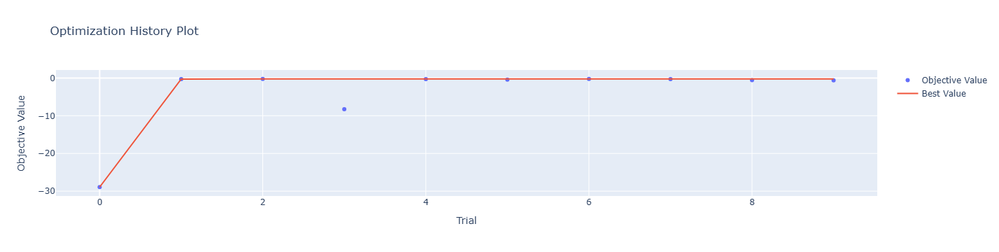

In [34]:
optuna.visualization.plot_optimization_history(study)

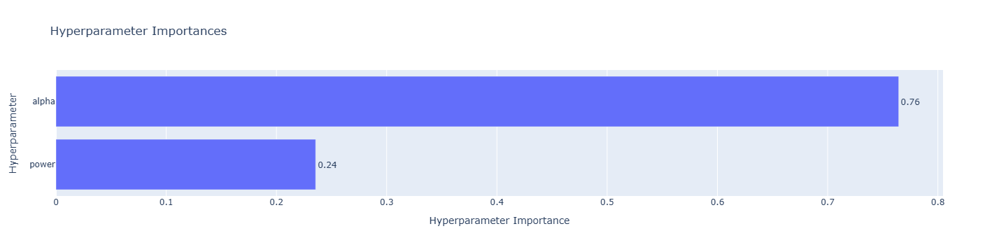

In [35]:
optuna.visualization.plot_param_importances(study)

The most important feature is "alpha". Nevertheless, "power" also contributes a bit to the model performance.

#### METRICS

Getting the best model and saving it.

In [38]:
model = TweedieRegressor(**study.best_params, max_iter=10000)
metrics = RegressionMetrics(model, X_selected, y)
metrics.save_model('../models/tweedieRegression.pkl')

Loading the model and evaluate it.

In [36]:
model = joblib.load("../models/tweedieRegression.pkl")
metrics = RegressionMetrics(model, X_selected, y)
metrics.Kfold_evaluation()
metrics.save_results("Tweedie")
metrics.printMetrics()

MSE: 0.2456
RMSE: 0.4956
R2: 0.9964
MAE: 0.3714
MAPE: 0.0065
Adjusted R2: 0.9964


The model has a low MSE and RMSE, and a high R2 value, which indicates that it will make good predictions.

## Quantile Regression


Determine the solver based on de SciPy version


In [5]:
from sklearn.metrics._dist_metrics import parse_version
from sklearn.utils.fixes import sp_version

solver = "highs" if sp_version >= parse_version("1.6.0") else "interior-point"

#### HYPERPARAMETER TUNING

Define the quantiles

In [6]:
quantiles = [0.05, 0.5, 0.95]
predictions = {}
out_bounds_predictions = np.zeros_like(y, dtype=np.bool_)

Due to the high training time of this algorithm, we are going to use a sample of 10000 rows.

In [37]:
X_sample = X_scaled.sample(n=10000,random_state=42)
y_sample = y.loc[X_sample.index]

Hyperparameter Tuning with Optuna

In [25]:
def objective(trial):
    alpha = trial.suggest_float('alpha', 1e-6, 1e-2, log=True)
    quantile = trial.suggest_categorical('quantile', quantiles)
    qr = QuantileRegressor(alpha=alpha, quantile=quantile)

    cv_scores = cross_val_score(qr, X_sample, y_sample, cv=3, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='Quantile Regression')
study.optimize(objective, n_trials=10)

[I 2024-12-23 13:07:23,530] A new study created in memory with name: Quantile Regression
[I 2024-12-23 13:07:48,978] Trial 0 finished with value: -0.04941330822220142 and parameters: {'alpha': 0.0004428301839309872, 'quantile': 0.5}. Best is trial 0 with value: -0.04941330822220142.
[I 2024-12-23 13:08:10,420] Trial 1 finished with value: -0.0972487949833812 and parameters: {'alpha': 7.76315163817968e-06, 'quantile': 0.05}. Best is trial 0 with value: -0.04941330822220142.
[I 2024-12-23 13:08:37,325] Trial 2 finished with value: -0.04944314003381491 and parameters: {'alpha': 1.4246930891233423e-06, 'quantile': 0.5}. Best is trial 0 with value: -0.04941330822220142.
[I 2024-12-23 13:08:56,180] Trial 3 finished with value: -0.09680958470937369 and parameters: {'alpha': 0.0004400251306745522, 'quantile': 0.05}. Best is trial 0 with value: -0.04941330822220142.
[I 2024-12-23 13:09:10,502] Trial 4 finished with value: -0.04974743079191569 and parameters: {'alpha': 0.003907289110671252, 'qua

#### STUDY RESULTS

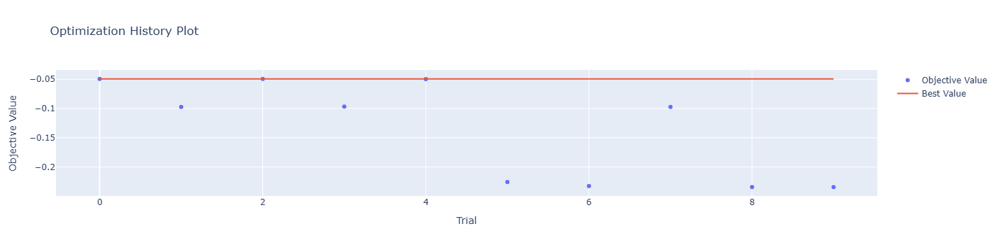

In [26]:
optuna.visualization.plot_optimization_history(study)


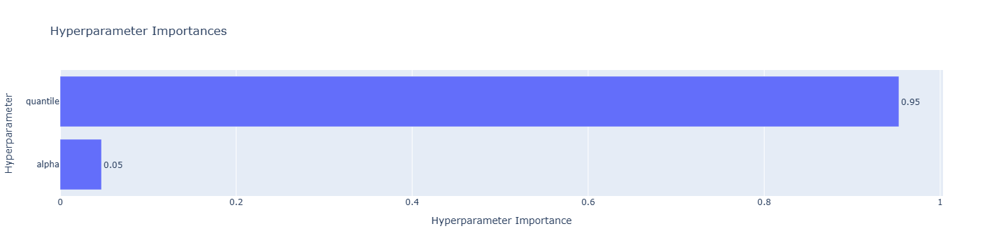

In [27]:
optuna.visualization.plot_param_importances(study)

"quantile" hyperparameter has an importance of 0.95, almost 1. Which means that contributes considerably to the model's performance, while "alpha" almost doesn't contribute.

#### METRICS

Getting the best model and saving it.

In [28]:
model = QuantileRegressor(**study.best_params)
metrics = RegressionMetrics(model, X_sample, y_sample)
metrics.save_model('../models/quantileRegression.pkl')

Loading the model and evaluating it.

In [38]:
model = joblib.load("../models/quantileRegression.pkl")
metrics = RegressionMetrics(model, X_sample, y_sample)
metrics.Kfold_evaluation()
metrics.save_results("Quantile")
metrics.printMetrics()

MSE: 0.0494
RMSE: 0.2221
R2: 0.9993
MAE: 0.1487
MAPE: 0.0025
Adjusted R2: 0.9993


The low value of MSE and RMSE indicates that the model is making good predictions. R2 is close to 1, which means that the model explains most of the variance in the target variable. MAPE is close to 0, which highlights the excellent performance of the model in terms of percentage error.

## Polynomial Regression


As we were having the "kernel has died" problem with this algorithm, we have decided to use a sample of 10000 rows.

In [39]:
X_sample = X_scaled.sample(n=10000,random_state=42)
y_sample = y.loc[X_sample.index]

Create polynomial features

In [40]:
poly_features = PolynomialFeatures(degree=2)
X_poly = poly_features.fit_transform(X_sample)

Train the model with the Polynomial Features. As we are using a Linear Regression Model, we are not doing the Hyperparameter tunning as LinearRegression doesn't have hyperparameters.

In [20]:
model = cuLinearRegression()
metrics = RegressionMetrics(model, X_poly, y_sample)
metrics.save_model('../models/polynomialRegression.pkl')

/home/aitor/anaconda3/envs/rapids-24.10/lib/python3.10/site-packages/cuml/internals/api_decorators.py:382: UserWarning:

Starting from version 23.08, the new 'copy_X' parameter defaults to 'True', ensuring a copy of X is created after passing it to fit(), preventing any changes to the input, but with increased memory usage. This represents a change in behavior from previous versions. With `copy_X=False` a copy might still be created if necessary. Explicitly set 'copy_X' to either True or False to suppress this warning.



In [41]:
model = joblib.load("../models/polynomialRegression.pkl")
metrics = RegressionMetrics(model, X_poly, y_sample)
metrics.Kfold_evaluation()
metrics.save_results("Polynomial")
metrics.printMetrics()

MSE: 70.4818
RMSE: 8.2368
R2: -0.0005
MAE: 6.0365
MAPE: 0.1035
Adjusted R2: -0.8724


The model's performance is poor, as indicated by the high error metrics. Negative R^2 and Adjusted R^2 suggests that the model performs worse than a simple mean-based prediction. The model is not capable of generalizing.

## Stochastic Gradient Descendent Regression

Using SelectFromModel to get the best features for Stochastic Gradient Descendent Regressor.

In [42]:
model = cuSGDRegressor()
selector = SelectFromModel(estimator=model).fit(X_scaled, y)
X_selected = selector.transform(X_scaled)

Due to high training times, we have decided to use a sample of 10000 rows.

In [43]:
X_sample = pd.DataFrame(X_selected).sample(n=10000,random_state=42)
y_sample = y.loc[X_sample.index]

#### HYPERPARAMETER TUNING

In [7]:
def objective(trial):
    alpha = trial.suggest_float('alpha', 1e-6, 1e-2, log=True)
    tol = trial.suggest_float('tol', 1e-6, 1e-2, log=True)
    eta0 = trial.suggest_float('eta0', 1e-6, 1e-2, log=True)
    penalty = trial.suggest_categorical('penalty', ['l1', 'l2', 'elasticnet']) 
    
    sgd = cuSGDRegressor(alpha= alpha, tol = tol, eta0=eta0, penalty=penalty)
    
    cv_scores= cross_val_score(sgd, X_sample, y_sample , cv=3, scoring= 'neg_mean_squared_error')
    
    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='SGDRegressor')

study.optimize(objective, n_trials=5)
    

[I 2024-12-23 16:16:15,490] A new study created in memory with name: SGDRegressor
[I 2024-12-23 16:17:37,478] Trial 0 finished with value: -0.044511981193950036 and parameters: {'alpha': 1.6855651016988507e-05, 'tol': 2.1306748331054356e-06, 'eta0': 0.006973338066818266, 'penalty': 'l1'}. Best is trial 0 with value: -0.044511981193950036.
[I 2024-12-23 16:18:41,066] Trial 1 finished with value: -0.9151827215955944 and parameters: {'alpha': 0.0001544800556248807, 'tol': 0.004385142691199446, 'eta0': 5.051811627571176e-06, 'penalty': 'elasticnet'}. Best is trial 0 with value: -0.044511981193950036.
[I 2024-12-23 16:20:04,600] Trial 2 finished with value: -0.044525674039281864 and parameters: {'alpha': 0.00011678178047875199, 'tol': 1.5063464863880717e-06, 'eta0': 0.00513427963407056, 'penalty': 'l2'}. Best is trial 0 with value: -0.044511981193950036.
[I 2024-12-23 16:20:15,446] Trial 3 finished with value: -0.581142975716157 and parameters: {'alpha': 0.0060961897998297555, 'tol': 0.0079

#### STUDY RESULTS

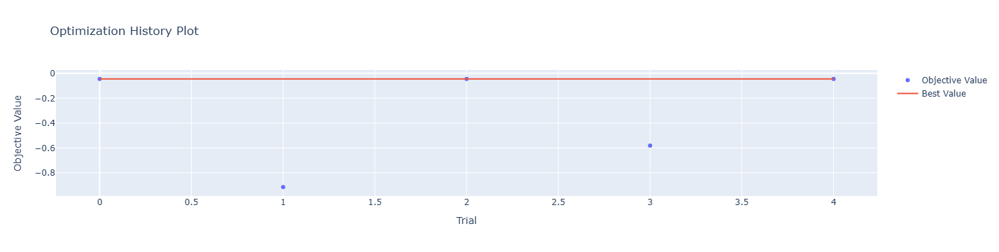

In [8]:
optuna.visualization.plot_optimization_history(study)

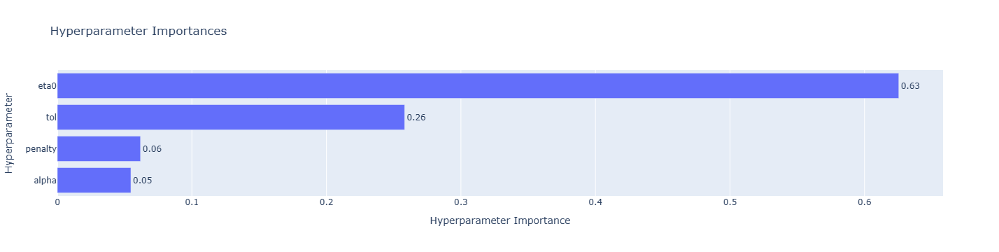

In [9]:
optuna.visualization.plot_param_importances(study)

The most important hyperparameter is "eta0" followed by "tol". "penalty" and "alpha" almost doesn't contribute to the model's performance.

#### METRICS

Getting the best model and saving it.

In [10]:
model = cuSGDRegressor(**study.best_params)
metrics=RegressionMetrics(model, X_sample, y_sample)
metrics.save_model('../models/sgdRegression.pkl')

Loading the model and evaluating it.

In [44]:
model = joblib.load('../models/sgdRegression.pkl')
metrics = RegressionMetrics(model, X_sample, y_sample)
metrics.Kfold_evaluation()
metrics.save_results("SGD")
metrics.printMetrics()

MSE: 0.0445
RMSE: 0.2109
R2: 0.9994
MAE: 0.1586
MAPE: 0.0027
Adjusted R2: 0.9994


The model demonstrates strong performance, with a high R2 (0.99) and Adjusted R2, indicating it explains nearly all variance in the target variable. Low MSE, RMSE, MAE, and MAPE suggest accurate predictions with minimal error. These metrics indicate that the model is both precise and reliable,

## Random Forest Regression

To train this model we need to use the type float32 in the data.

In [45]:
X_scaled_32 = X_scaled.astype(np.float32)

#### HYPERPARAMETER TUNING

In [8]:
def objective(trial):
    gc.collect()
    cp._default_memory_pool.free_all_blocks()

    n_estimators = trial.suggest_int('n_estimators', 50, 500)
    max_depth = trial.suggest_int('max_depth', 3, 30)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 20)
    bootstrap = trial.suggest_categorical('bootstrap', [True, False])

    
    rf = cuRandomForestRegressor(n_estimators=n_estimators, max_depth=max_depth, min_samples_split= min_samples_split,
                                 min_samples_leaf= min_samples_leaf, bootstrap= bootstrap)
    cv_scores = cross_val_score(rf, X_scaled_32, y, cv=5, scoring='neg_mean_squared_error')
    return np.mean(cv_scores)
    
study= optuna.create_study(direction= 'maximize', study_name = 'Random Forest')
study.optimize(objective, n_trials=10)


[I 2024-12-23 14:07:15,213] A new study created in memory with name: Random Forest
[I 2024-12-23 14:08:29,082] Trial 0 finished with value: -1.7620206126168938 and parameters: {'n_estimators': 391, 'max_depth': 30, 'min_samples_split': 20, 'min_samples_leaf': 4, 'bootstrap': False}. Best is trial 0 with value: -1.7620206126168938.
[I 2024-12-23 14:09:17,131] Trial 1 finished with value: -3.239693597697942 and parameters: {'n_estimators': 349, 'max_depth': 15, 'min_samples_split': 5, 'min_samples_leaf': 1, 'bootstrap': True}. Best is trial 0 with value: -1.7620206126168938.
[I 2024-12-23 14:10:09,598] Trial 2 finished with value: -1.9842869871322109 and parameters: {'n_estimators': 303, 'max_depth': 20, 'min_samples_split': 10, 'min_samples_leaf': 4, 'bootstrap': False}. Best is trial 0 with value: -1.7620206126168938.
[I 2024-12-23 14:10:33,264] Trial 3 finished with value: -2.731597813637275 and parameters: {'n_estimators': 162, 'max_depth': 17, 'min_samples_split': 17, 'min_samples_l

#### STUDY RESULTS

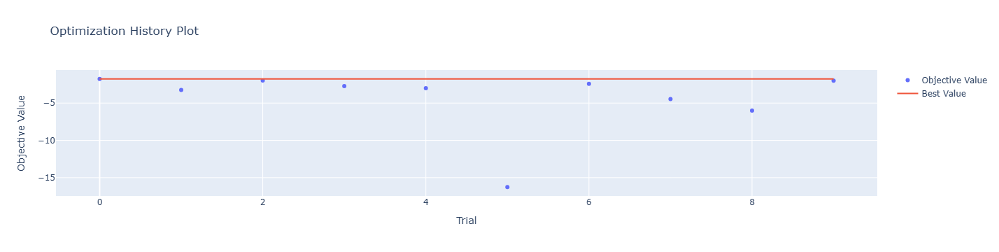

In [9]:
optuna.visualization.plot_optimization_history(study)


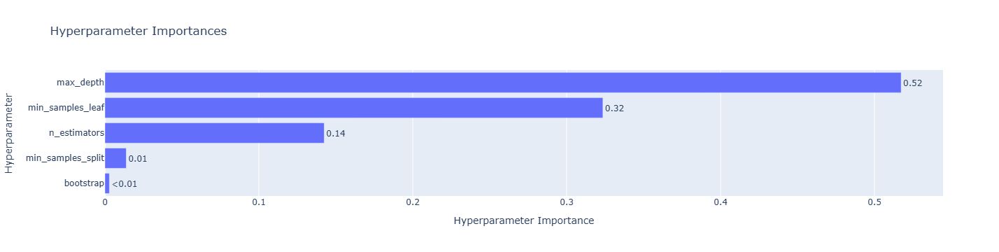

In [10]:
optuna.visualization.plot_param_importances(study)

The most important hyperparameter is "max_depth", folowed by "min_samples_leaf" and "n_estimators". "min_samples_split" and "bootstrap" almost don't contribute to the model's performance.

#### METRICS

Getting the best model and saving it.

In [12]:
model = cuRandomForestRegressor(**study.best_params)
metrics=RegressionMetrics(model, X_scaled, y)
metrics.save_model('../models/randomForestRegression.pkl')

Load the model and evaluate it.

In [46]:
model = joblib.load('../models/randomForestRegression.pkl')
metrics = RegressionMetrics(model, X_scaled_32, y)
metrics.Kfold_evaluation()
metrics.save_results("Random Forest")
metrics.printMetrics()

MSE: 1.7099
RMSE: 1.3076
R2: 0.9752
MAE: 0.9561
MAPE: 0.0165
Adjusted R2: 0.9751


The model shows excellent performance with low error metrics and high accuracy metrics, indicating it explains the 97.5% of the variance. The very low MAPE suggests that the prediction errors are minimal relative to the actual values. 

## Gaussian Process Regression


Due to a Memory Error with this algorithm, we are only using a sample of 1000 rows.

In [47]:
X_sample = X_scaled.sample(n=1000,random_state=42)
y_sample = y.loc[X_sample.index]

#### HYPERPARAMETER TUNING

In [18]:
def objective(trial):
    length_scale = trial.suggest_float('length_scale', 1e-5, 5, log=True)  # Coherencia con el kernel
    constant_value = trial.suggest_float('constant_value', 1e-5, 5, log=True)  # Coherencia con el kernel
    kernel = C(constant_value, (1e-4, 1e1)) * RBF(length_scale, (1e-4, 1e1))
    alpha = trial.suggest_float("alpha", 1e-10, 1e-1, log=True)

    gpr = GaussianProcessRegressor(alpha=alpha,kernel=kernel, random_state=42)
    
    cv_scores = cross_val_score(gpr, X_sample, y_sample, cv=5, scoring="neg_mean_squared_error")
    
    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='Gaussian Process Regression')
study.optimize(objective, n_trials=50)

[I 2024-12-23 14:31:04,847] A new study created in memory with name: Gaussian Process Regression
/home/aitor/anaconda3/envs/rapids-24.10/lib/python3.10/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/aitor/anaconda3/envs/rapids-24.10/lib/python3.10/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.
  warnings.warn(
/home/aitor/anaconda3/envs/rapids-24.10/lib/python3.10/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning: The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 1

#### STUDY RESULTS

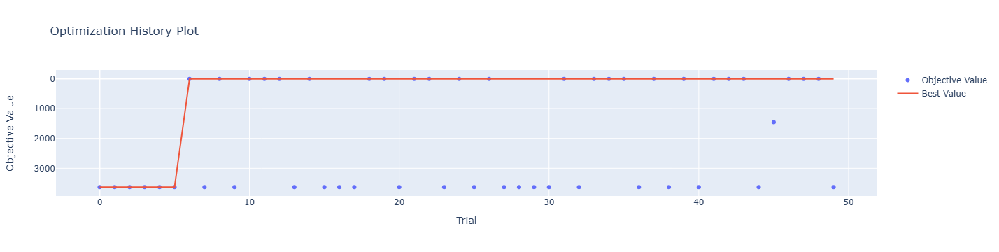

In [19]:
optuna.visualization.plot_optimization_history(study)

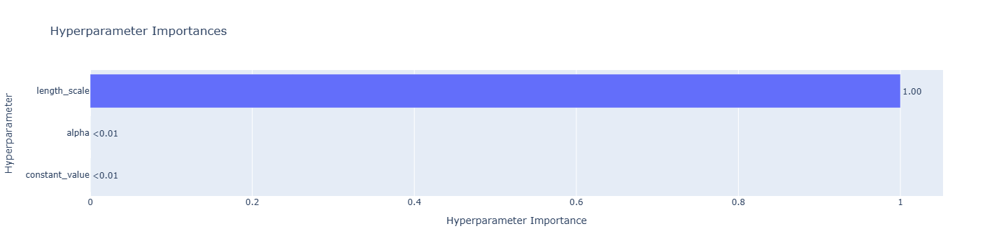

In [20]:
optuna.visualization.plot_param_importances(study)

As "length_scale" takes all the importance (1.00), it means that "alpha" and "constant_value" don't contribute to the model's performance.

#### METRICS

Getting the best model and saving it.

In [28]:
kernel = C(study.best_params['constant_value'], (1e-4, 1e1))* RBF(study.best_params['length_scale'], (1e-4, 1e1))
alpha = study.best_params["alpha"]
model = GaussianProcessRegressor(alpha = alpha, kernel = kernel)
metrics=RegressionMetrics(model, X_sample, y_sample)
metrics.save_model('../models/gpr.pkl')

Load the model and evaluate it.

In [48]:
model = joblib.load('../models/gpr.pkl')
metrics = RegressionMetrics(model, X_sample, y_sample)
metrics.Kfold_evaluation()
metrics.save_results("GPR")
metrics.printMetrics()

/home/aitor/anaconda3/envs/rapids-24.10/lib/python3.10/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning:

The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.

/home/aitor/anaconda3/envs/rapids-24.10/lib/python3.10/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning:

The optimal value found for dimension 0 of parameter k2__length_scale is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.

/home/aitor/anaconda3/envs/rapids-24.10/lib/python3.10/site-packages/sklearn/gaussian_process/kernels.py:452: ConvergenceWarning:

The optimal value found for dimension 0 of parameter k1__constant_value is close to the specified upper bound 10.0. Increasing the bound and calling fit again may find a better value.

/home/aitor/anaconda3/envs/rapids-24.10/lib/python3.10

MSE: 6.8922
RMSE: 2.6085
R2: 0.8996
MAE: 1.7044
MAPE: 0.0282
Adjusted R2: 0.8891


The model demonstrates strong performance, with reasonably low error metrics. It explains nearly the 90% of the variance. The MAPE shows that prediction errors are small relative to actual values, reflecting good accuracy. While the model performs well, other models perform better.

## Decision Tree Regression

We use SelectFromModel to get the best features for DecisionTreeRegressor

In [49]:
dt = DecisionTreeRegressor()
selector = SelectFromModel(estimator=dt).fit(X_scaled, y)
X_selected = selector.transform(X_scaled)

#### HYPERPARAMETER TUNING

In [9]:
def objective(trial):
    criterion = trial.suggest_categorical('criterion', ['squared_error', 'friedman_mse', 'poisson'])
    splitter = trial.suggest_categorical('splitter', ['best', 'random'])
    max_depth = trial.suggest_int('max_depth', 1, 20)
    min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 20)

    dt = DecisionTreeRegressor(
        criterion=criterion,
        splitter=splitter,
        max_depth=max_depth,
        min_samples_split=min_samples_split,
        min_samples_leaf=min_samples_leaf,
        random_state=42
    )

    cv_scores = cross_val_score(dt, X_selected, y, cv=5, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='Decision Tree Regression')
study.optimize(objective, n_trials=10)

[I 2024-12-23 16:31:46,016] A new study created in memory with name: Decision Tree Regression
[I 2024-12-23 16:31:46,902] Trial 0 finished with value: -0.016056479449091825 and parameters: {'criterion': 'poisson', 'splitter': 'best', 'max_depth': 11, 'min_samples_split': 2, 'min_samples_leaf': 16}. Best is trial 0 with value: -0.016056479449091825.
[I 2024-12-23 16:31:47,024] Trial 1 finished with value: -6.580291831858242 and parameters: {'criterion': 'friedman_mse', 'splitter': 'random', 'max_depth': 7, 'min_samples_split': 3, 'min_samples_leaf': 17}. Best is trial 0 with value: -0.016056479449091825.
[I 2024-12-23 16:31:47,492] Trial 2 finished with value: -1.6806172233920857 and parameters: {'criterion': 'poisson', 'splitter': 'best', 'max_depth': 4, 'min_samples_split': 2, 'min_samples_leaf': 15}. Best is trial 0 with value: -0.016056479449091825.
[I 2024-12-23 16:31:47,780] Trial 3 finished with value: -0.015984005990230882 and parameters: {'criterion': 'friedman_mse', 'splitter'

#### STUDY RESULTS

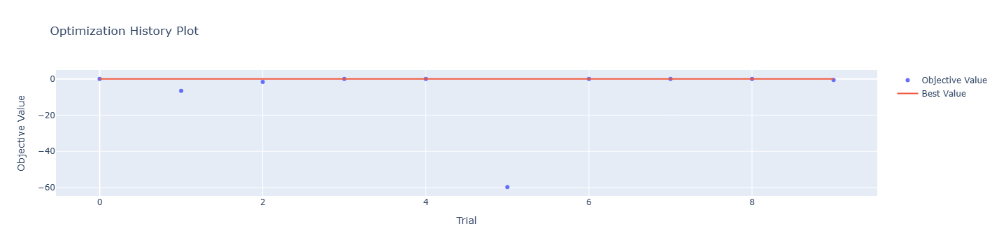

In [10]:
optuna.visualization.plot_optimization_history(study)

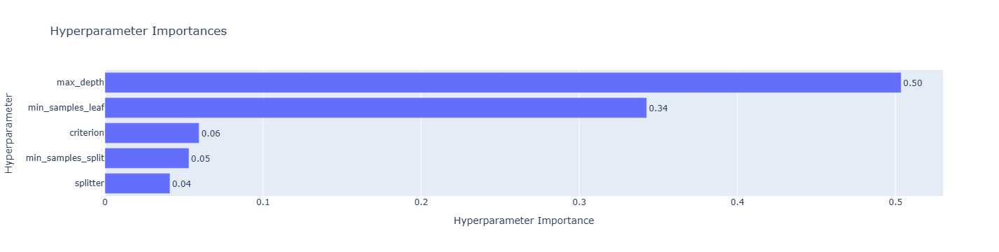

In [11]:
optuna.visualization.plot_param_importances(study)

The most important hyperparameter is "max_depth", followed by "min_samples_leaf". "criterion", "min_samples_split" and "splitter" almost don't contribute to the model's performance.

#### METRICS

Getting the best model and saving it.

In [12]:
model = DecisionTreeRegressor(**study.best_params, random_state=42)
metrics=RegressionMetrics(model, X_selected, y)
metrics.save_model('../models/decisionTreeRegression.pkl')

Loading the model and evaluating it.

In [51]:
model = joblib.load('../models/decisionTreeRegression.pkl')
metrics = RegressionMetrics(model, X_selected, y)
metrics.Kfold_evaluation()
metrics.save_results("Decision Tree")
metrics.printMetrics()

MSE: 0.0026
RMSE: 0.0512
R2: 1.0
MAE: 0.0238
MAPE: 0.0004
Adjusted R2: 1.0


The model shows near perfect performance, with extremely low error metrics and maximum R^2 and Adjusted R^2 values of 1.0, indicating it explains all the variance in the data. The minimal MAPE confirms that the prediction errors are negligible relative to actual values. These results suggest an ideal fit.

## RANSAC Regression

#### HYPERPARAMETER TUNING

In [19]:
def objective_ransac(trial):
    min_samples = trial.suggest_int('min_samples', 10000, 200000)
    residual_threshold = trial.suggest_float('residual_threshold', 0.1, 10.0)
    max_trials = trial.suggest_int('max_trials', 100, 1000)

    ransac = RANSACRegressor(
        min_samples=min_samples,
        residual_threshold=residual_threshold,
        max_trials=max_trials,
        random_state=42
    )

    cv_scores = cross_val_score(ransac, X_scaled, y, cv=5, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='RANSAC Regression')
study.optimize(objective_ransac, n_trials=10)

[I 2024-12-23 15:16:26,243] A new study created in memory with name: RANSAC Regression
[I 2024-12-23 15:16:35,933] Trial 0 finished with value: -0.04358727721624547 and parameters: {'min_samples': 34769, 'residual_threshold': 9.381016477615908, 'max_trials': 979}. Best is trial 0 with value: -0.04358727721624547.
[I 2024-12-23 15:16:44,440] Trial 1 finished with value: -0.04358727721624547 and parameters: {'min_samples': 68199, 'residual_threshold': 7.747147725156117, 'max_trials': 703}. Best is trial 0 with value: -0.04358727721624547.
[I 2024-12-23 15:16:53,235] Trial 2 finished with value: -0.04358727721624547 and parameters: {'min_samples': 155146, 'residual_threshold': 8.811753299800055, 'max_trials': 686}. Best is trial 0 with value: -0.04358727721624547.
[I 2024-12-23 15:17:02,867] Trial 3 finished with value: -0.04358727721624547 and parameters: {'min_samples': 39446, 'residual_threshold': 2.8767121668544156, 'max_trials': 295}. Best is trial 0 with value: -0.04358727721624547.

#### STUDY RESULTS

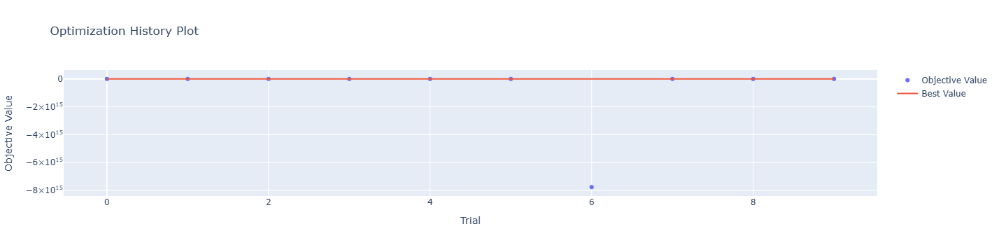

In [20]:
optuna.visualization.plot_optimization_history(study)

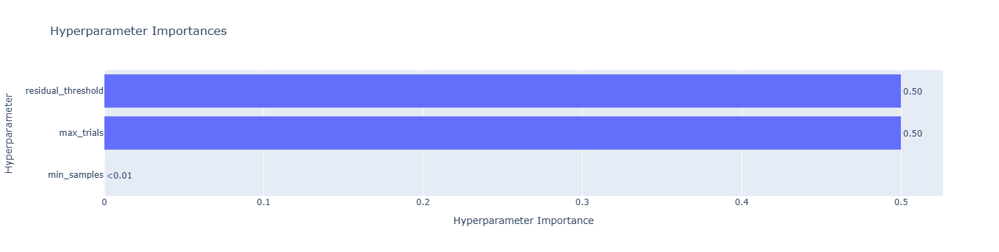

In [21]:
optuna.visualization.plot_param_importances(study)

While "residual_threshold" and "max_trials" have the same importance (0.5), "min_samples" doesn't contribute to the model's performance.

#### METRICS

Getting the best model and saving it.

In [22]:
model = RANSACRegressor(**study.best_params, random_state=42)
metrics=RegressionMetrics(model,X_scaled, y)
metrics.save_model('../models/ransac.pkl')

Load the model and evaluate it.

In [52]:
model = joblib.load('../models/ransac.pkl')
metrics = RegressionMetrics(model, X_scaled, y)
metrics.Kfold_evaluation()
metrics.save_results("RANSAC")
metrics.printMetrics()

MSE: 0.0436
RMSE: 0.2088
R2: 0.9994
MAE: 0.1551
MAPE: 0.0027
Adjusted R2: 0.9994


The model demonstrates excellent performance, with very low error metrics and extremely high R^2 and Adjusted R^2 values of 0.9994, indicating it explains nearly all the variance in the data. The MAPE highlights minimal relative errors, showcasing high precision and accuracy. Overall, the model is highly effective for the regression task

## TheilSen Regression

#### HYPERPARAMETER TUNING

In [25]:
def objective_theilsen(trial):
    max_subpopulation = trial.suggest_int('max_subpopulation', 1, 1000)
    n_subsamples = trial.suggest_int('n_subsamples', 1, 10000)
    max_iter = trial.suggest_int('max_iter', 100, 1000)

    theilsen = TheilSenRegressor(
        max_subpopulation=max_subpopulation,
        n_subsamples=n_subsamples,
        max_iter=max_iter,
        random_state=42
    )

    cv_scores = cross_val_score(theilsen, X_scaled, y, cv=5, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='Theil-Sen Regression')
study.optimize(objective_theilsen, n_trials=3)

[I 2024-12-23 15:37:44,073] A new study created in memory with name: Theil-Sen Regression
[I 2024-12-23 15:38:59,128] Trial 0 finished with value: -1.7904094862540806e+17 and parameters: {'max_subpopulation': 492, 'n_subsamples': 9109, 'max_iter': 791}. Best is trial 0 with value: -1.7904094862540806e+17.
[I 2024-12-23 15:39:36,910] Trial 1 finished with value: -4.968419718265543e+18 and parameters: {'max_subpopulation': 743, 'n_subsamples': 859, 'max_iter': 618}. Best is trial 0 with value: -1.7904094862540806e+17.
[I 2024-12-23 15:41:50,954] Trial 2 finished with value: -2.4447035581871933e+17 and parameters: {'max_subpopulation': 828, 'n_subsamples': 8343, 'max_iter': 800}. Best is trial 0 with value: -1.7904094862540806e+17.


#### STUDY RESULTS

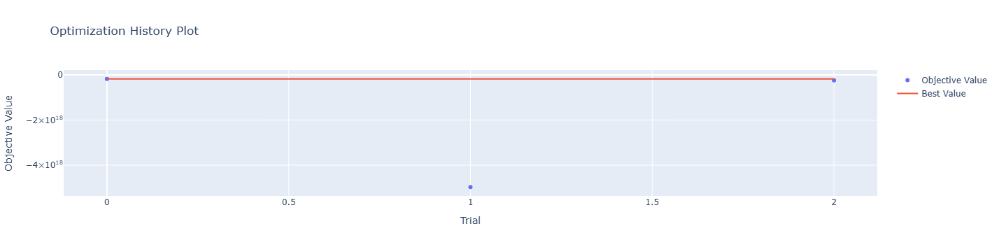

In [26]:
optuna.visualization.plot_optimization_history(study)

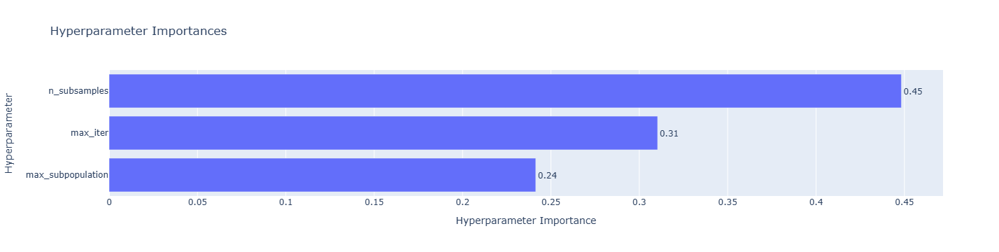

In [27]:
optuna.visualization.plot_param_importances(study)

"n_subsamples" is the most important hyperparameter, followed by "max_iter" and "max_subpopulation". The three hyperparameters contribute to the model's performance.

#### METRICS

Getting the best model and saving it.

In [28]:
model = TheilSenRegressor(**study.best_params, random_state=42)
metrics=RegressionMetrics(model,X_scaled, y)
metrics.save_model('../models/theilsen.pkl')

Loading the best model and evaluating it.

In [53]:
model = joblib.load('../models/theilsen.pkl')
metrics = RegressionMetrics(model, X_scaled, y)
metrics.Kfold_evaluation()
metrics.save_results("Theil Shen")
metrics.printMetrics()

MSE: 2.5338141164362243e+17
RMSE: 340113934.0527
R2: -3686481349985469.0
MAE: 3184382.0387
MAPE: 55918.3399
Adjusted R2: -3687796106842389.0


The model's performance is catastrophic, with astronomical error metrics and highly negative R^2 and Adjusted R^2 values, indicating it performs far worse than a simple mean prediction. The MAE and MAPE are exceptionally high, showing enormous absolute and relative errors. These results suggest severe issues.

## Huber Regression

#### HYPERPARAMETER TUNING

In [30]:
def objective_huber(trial):
    epsilon = trial.suggest_float('epsilon', 1.1, 2.0)
    alpha = trial.suggest_float('alpha', 1e-6, 1e-2, log=True)

    huber = HuberRegressor(
        epsilon=epsilon,
        alpha=alpha,
        max_iter=1000
    )

    cv_scores = cross_val_score(huber, X_scaled, y, cv=5, scoring='neg_mean_squared_error')

    return np.mean(cv_scores)

study = optuna.create_study(direction='maximize', study_name='Huber Regression')
study.optimize(objective_huber, n_trials=3)

[I 2024-12-23 15:46:08,056] A new study created in memory with name: Huber Regression
[I 2024-12-23 15:47:47,721] Trial 0 finished with value: -0.0441227088696882 and parameters: {'epsilon': 1.9706146706469143, 'alpha': 5.7910676508018985e-06}. Best is trial 0 with value: -0.0441227088696882.
[I 2024-12-23 15:49:48,004] Trial 1 finished with value: -0.048145644482665506 and parameters: {'epsilon': 1.1190738741306683, 'alpha': 3.022683493613243e-06}. Best is trial 0 with value: -0.0441227088696882.
[I 2024-12-23 15:51:25,595] Trial 2 finished with value: -0.044252071742027874 and parameters: {'epsilon': 1.8832223789387172, 'alpha': 0.00024574513010849024}. Best is trial 0 with value: -0.0441227088696882.


#### STUDY RESULTS

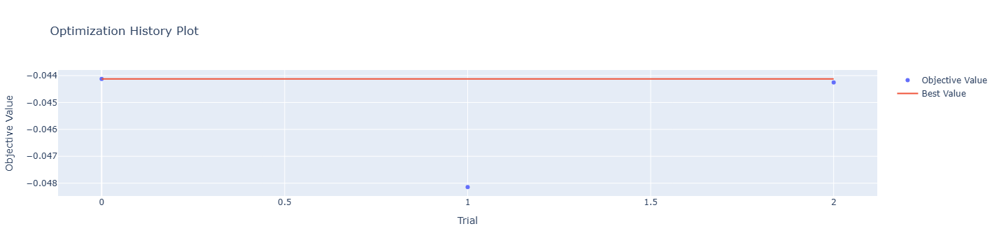

In [31]:
optuna.visualization.plot_optimization_history(study)

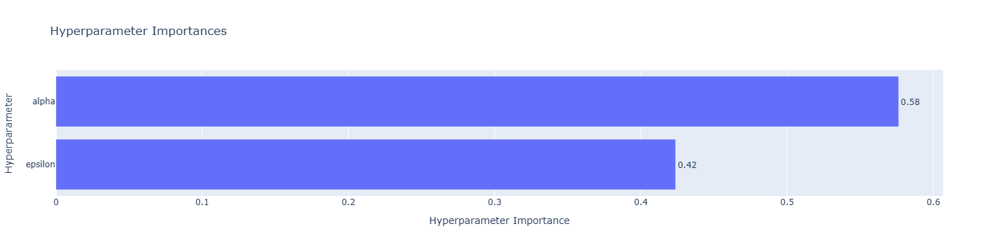

In [32]:
optuna.visualization.plot_param_importances(study)

"alpha" is the most important hyperparameter. However, "epsilon" is also impotant for the model performance. 

#### METRICS

Getting the best model and saving it.

In [34]:
model = HuberRegressor(**study.best_params, max_iter=1000)
metrics=RegressionMetrics(model,X_scaled, y)
metrics.save_model('../models/huber.pkl')

Load the model and evaluating it.

In [54]:
model = joblib.load('../models/huber.pkl')
metrics = RegressionMetrics(model, X_scaled, y)
metrics.Kfold_evaluation()
metrics.save_results("Huber")
metrics.printMetrics()

MSE: 0.0441
RMSE: 0.21
R2: 0.9994
MAE: 0.1505
MAPE: 0.0026
Adjusted R2: 0.9994


The model demonstrates excellent predictive performance, with very low error metrics and high accuracy, indicating it explains nearly all the variance in the target variable. The extremely low MAPE reflects minimal relative errors, confirming strong precision and reliability. Overall, it is an excellent model.

## Conclusions Classification

In [55]:
RegressionMetrics.printResults()

Algorithm,MSE,RMSE,R2,MAE,MAPE,Adjusted R2
Linear Regression,0.2096,0.3478,0.9970,0.2769,0.0048,0.9970
Lasso,0.0436,0.2088,0.9994,0.1551,0.0027,0.9994
Linear SVR,0.0440,0.2098,0.9994,0.1561,0.0027,0.9994
Non-Linear SVR,0.0748,0.2711,0.9989,0.1325,0.0023,0.9989
KNN,13.6241,3.6910,0.8020,2.8751,0.0501,0.8019
Tweedie,0.2456,0.4956,0.9964,0.3714,0.0065,0.9964
Quantile,0.0494,0.2221,0.9993,0.1487,0.0025,0.9993
Polynomial,70.4818,8.2368,-0.0005,6.0365,0.1035,-0.8724
SGD,0.0445,0.2109,0.9994,0.1586,0.0027,0.9994
Random Forest,1.7099,1.3076,0.9752,0.9561,0.0165,0.9751


In our evaluation of the regression models, the results vary significantly, and we believe that several factors contribute to the performance observed.

Starting with the models that performed exceptionally well, the Lasso regression, Linear SVR, Non-Linear SVR, Quantile, SGD, Ransac, and Huber all produced excellent results. These models demonstrated strong predictive power, with Lasso effectively handling feature selection through its regularization, and both versions of SVR (Linear and Non-Linear) showing a great ability to capture the underlying patterns in the data, particularly with the Non-Linear SVR managing to identify more complex relationships. The Quantile regressor was also very effective, delivering consistent and reliable predictions, particularly when dealing with outliers or skewed distributions. SGD and Ransac performed remarkably well by managing to handle large-scale data and robustness to outliers, respectively. The Huber regressor, which is robust to outliers, proved its effectiveness as well.

The Decision Tree regressor achieved almost perfect results, suggesting that it is highly capable of capturing complex relationships within the data by making optimal splits at each node. This makes it an ideal choice for handling intricate non-linear patterns.

On the other hand, the KN Regressor performed poorly, which could be due to its sensitivity to the choice of distance metric or the curse of dimensionality. This model struggles when the data has many features or is not sufficiently well-prepared, leading to bad results.

The Theil-Sen estimator, unfortunately, showed catastrophic performance. This model, which is robust to outliers, may have been unable to effectively capture the trends in our specific dataset, possibly due to its sensitivity to the number of outliers or its assumptions about the underlying data distribution.

Lastly, the Linear Regression and Tweedie regressors performed well but did not quite reach the level of excellence seen in some other models. Linear Regression handled the relationships in the data effectively but lacked the complexity needed to capture more intricate patterns. The Tweedie regressor performed decently, showing good predictive power but potentially limited by its assumptions about the data distribution.